In [1]:
import matplotlib.pyplot as plt
%matplotlib inline

import numpy as np
import pandas as pd
import pickle

import helper
from IPython.display import display, HTML
import seaborn as sns

In [2]:
df_orig = helper.get_data()

In [3]:
df_orig.shape

(18110, 20)

### 25 clusters

In [4]:
# 21 (18 clusters), 28 (22 clusters), 41 (25 clusters) - dataset1 (without 01)
df = helper.get_cluster_df(df_orig, idx = 41, expected_cluster = 25)

/home/nandy/repository/git/agp/helper.py:110: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  df_fossil = df_fossil.groupby(['clust'])['fossil','green'].sum().sort_values('fossil', ascending = False)


### Avg energy shares

In [6]:
fuel_cols = ['wind', 'solar', 'solar_rooftop','blackcoal', 'browncoal','gas','diesel','kerosene','hydro','bagasse','batterys', 'net_import']
additional_cols = ['demand', 'rrp', 'export']

In [7]:
pd.set_option('display.max_columns', 200)
pd.set_option('display.max_rows', 100)
pd.set_option('display.min_rows', 100)
pd.set_option('display.expand_frame_repr', True)

In [8]:
X = df[['clust'] + fuel_cols]
X = X.groupby(['clust']).agg(['mean', 'std']).reset_index().apply(lambda x: round(x, 2))
X = X.rename(columns = {'clust' : 'cluster'})
with pd.option_context('display.max_rows', None, 'display.max_columns', None): 
    display(HTML(X.to_html(index = False))) 
X.to_csv('results/internal_cluster_shares.csv', index = False)

In [10]:
X = df[['clust'] + additional_cols]
X = X.groupby(['clust']).agg(['mean', 'std']).reset_index().apply(lambda x: round(x, 2))
X = X.rename(columns = {'clust' : 'cluster'})
with pd.option_context('display.max_rows', None, 'display.max_columns', None): 
    display(HTML(X.to_html(index = False))) 
X.to_csv('results/external_cluster_shares.csv', index = False)

### Cluster distribution

In [9]:
helper.plot_cluster_percentages(df, reorder = True)

clust,count,percentage
7,2120,11.71
3,2056,11.35
1,1928,10.65
16,1785,9.86
10,1332,7.36
4,1254,6.92
25,1224,6.76
23,859,4.74
24,782,4.32
22,757,4.18


### Cluster distribution by state

In [7]:
t = helper.get_cluster_state_shares(df)
print(t)

state    NSW1    QLD1     SA1    TAS1    VIC1
clust                                        
1         0.0  1928.0     0.0     0.0     0.0
2         0.0   380.0     0.0     0.0     0.0
3         0.0     0.0     0.0     0.0  2056.0
4         1.0  1253.0     0.0     0.0     0.0
5         0.0    57.0     0.0     0.0     0.0
6        73.0     0.0     0.0     0.0     0.0
7      2118.0     2.0     0.0     0.0     0.0
8         0.0     0.0     0.0     0.0   475.0
9         0.0     0.0     0.0     0.0   366.0
10     1330.0     2.0     0.0     0.0     0.0
11      100.0     0.0     0.0     0.0     0.0
12        0.0     0.0     0.0     0.0   439.0
13        0.0     0.0     0.0     0.0   286.0
14        0.0     0.0     1.0     0.0     0.0
15        0.0     0.0   323.0     0.0     0.0
16        0.0     0.0  1785.0     0.0     0.0
17        0.0     0.0   101.0     0.0     0.0
18        0.0     0.0    16.0     0.0     0.0
19        0.0     0.0   238.0     0.0     0.0
20        0.0     0.0   620.0     

### Cluster plot by state and individual days

In [64]:
X = df[['state', 'year', 'month', 'day', 'clust', 'probs']]
X = helper.get_cluster_assignment_day(X)

months=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sept', 'Oct', 'Nov', 'Dec']
X.loc[:,'month'] = pd.Categorical(X['month'].map(lambda x: months[x-1]), categories=months, ordered=True)

X = X.pivot_table(index = ['state', 'month'], columns =['year', "day"], values = "clust")

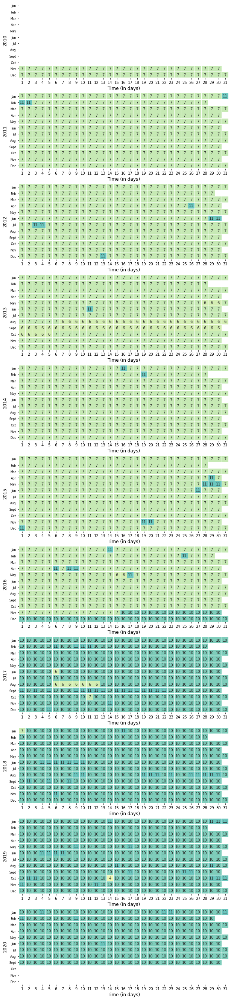

In [49]:
# years = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
years = list(range(2010, 2021))
fig, ax = plt.subplots(11, 1, figsize=(10, 48))
for idx in range(0, 11):
    d = X.loc['NSW1'][years[idx]]
    g = sns.heatmap(d,annot=True, vmin = 1, vmax = 25, 
                    yticklabels=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sept', 'Oct', 'Nov', 'Dec'],
                    linewidths=.5, cmap="YlGnBu", ax = ax[idx], cbar = False,
                   mask = d.isnull())
    g.set_yticklabels(g.get_yticklabels(), rotation = 0, fontsize = 8)
    ax[idx].set_xlabel('Time (in days)')
    ax[idx].set_ylabel('{}'.format(years[idx]))
    ax[idx].xaxis.label.set_size(12)
    ax[idx].yaxis.label.set_size(12)

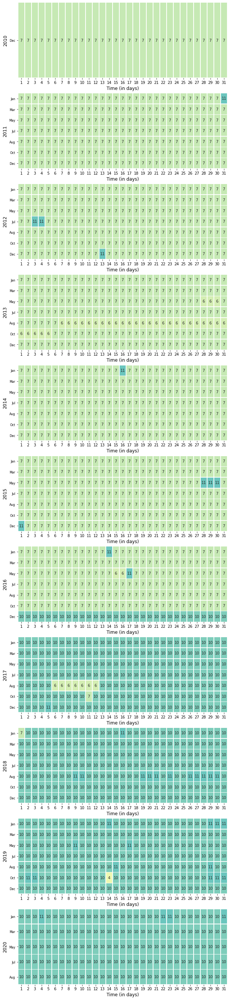

In [66]:
years = list(range(2010, 2021))
fig, ax = plt.subplots(11, 1, figsize=(10, 48))
for idx in range(0, 11):
    d = X.loc['NSW1'][years[idx]].dropna()
    g = sns.heatmap(d,annot=True, vmin = 1, vmax = 25, 
#                     yticklabels=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sept', 'Oct', 'Nov', 'Dec'],
                    linewidths=.5, cmap="YlGnBu", ax = ax[idx], cbar = False)
#                    mask = X.loc['NSW1'][years[idx]].isnull())
    g.set_yticklabels(g.get_yticklabels(), rotation = 0, fontsize = 8)
    ax[idx].set_xlabel('Time (in days)')
    ax[idx].set_ylabel('{}'.format(years[idx]))
    ax[idx].xaxis.label.set_size(12)
    ax[idx].yaxis.label.set_size(12)

### Cluster plot by state and months

In [71]:
X.head()

year         2010  2011  2012  2013  2014  2015  2016  2017  2018  2019  2020
state month                                                                  
NSW1  1       NaN   7.0   7.0   7.0   7.0   7.0   7.0  10.0  10.0  10.0  10.0
      2       NaN   7.0   7.0   7.0   7.0   7.0   7.0  10.0  10.0  10.0  10.0
      3       NaN   7.0   7.0   7.0   7.0   7.0   7.0  10.0  10.0  10.0  10.0
      4       NaN   7.0   7.0   7.0   7.0   7.0   7.0  10.0  10.0  10.0  10.0
      5       NaN   7.0   7.0   7.0   7.0   7.0   7.0  10.0  10.0  10.0  10.0

/home/nandy/repository/git/p3_venv/lib/python3.6/site-packages/pandas/core/indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
/home/nandy/repository/git/p3_venv/lib/python3.6/site-packages/pandas/core/indexing.py:1743: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(ilocs[0], value)


unique clusters [ 1  2  3  4  6  7  8  9 10 11 12 13 16 17 19 20 21 22 23 24 25]


Text(0.5, 159.0, 'Time (in years)')

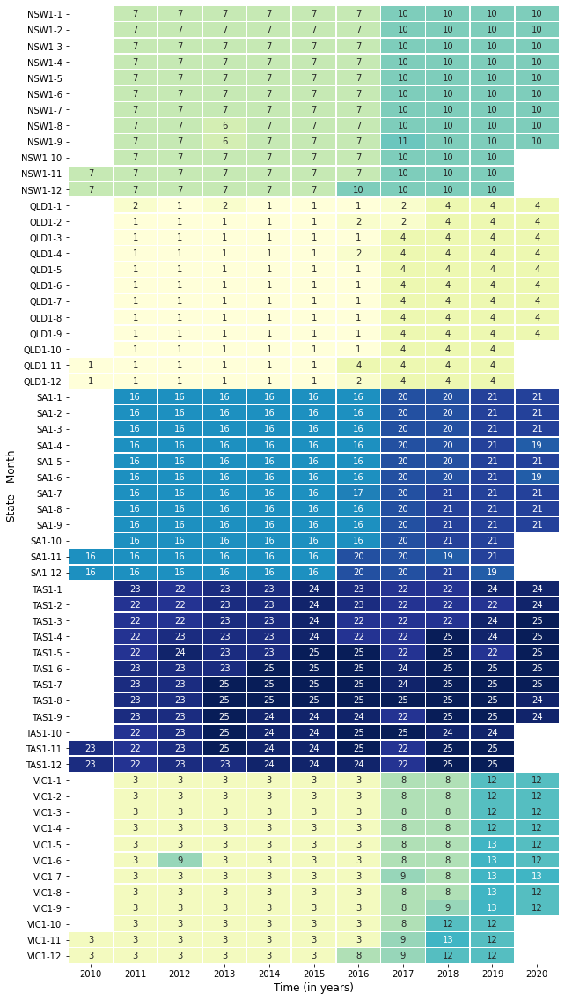

In [79]:

X = df[['datetime', 'state', 'year', 'month', 'clust', 'probs']]
X = helper.get_cluster_assignment_month(X)

print('unique clusters {}'.format(np.sort(X['clust'].unique())))

X = X.pivot_table(index = ['state', 'month'], columns = "year", values = "clust")
fig, ax = plt.subplots(figsize=(10, 20))  

sns.heatmap(X,annot=True, vmin = 1, vmax = 25, 
            linewidths=.5, cmap="YlGnBu", ax = ax, cbar = False)

plt.ylabel('State - Month', fontsize = 12)
plt.xlabel('Time (in years)', fontsize = 12)

### Demand

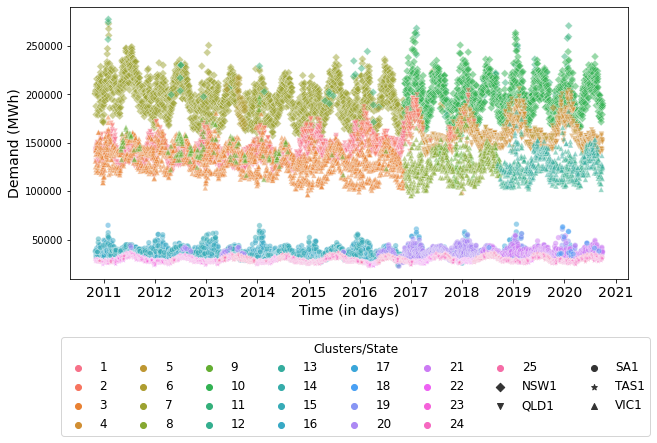

In [217]:
fig, ax = plt.subplots(figsize=(10, 5))
X = df.copy()
# mkr_dict = {'NSW1': 'x', 'QLD1': 'v', 'SA1': 'o', 'VIC1':'^', 'TAS1' :'1'}
mkr_dict ={'NSW1': 'D', 'QLD1': 'v', 'SA1': 'o', 'VIC1':'^', 'TAS1' :'*'}
g = sns.scatterplot(x = 'datetime', y = 'demand', hue='clust_category', style='state', s = 30,
                    markers = mkr_dict, data = X, alpha = 0.5, legend='brief')

handles, labels = ax.get_legend_handles_labels()

labels = labels[1:26] + labels[27:]
handles = handles[1:26] + handles[27:]
g.legend(handles=handles, labels=labels, fontsize = 12,
        loc=4, ncol= 8, bbox_to_anchor=(1.05, -0.6), title = 'Clusters/State',title_fontsize = 12)
# legend = g.legend()
# legend.texts[0].set_text("Clusters")
# legend.texts[1].set_text("State")


# Set x-axis label
plt.xlabel('Time (in days)', fontsize = 14)
a = plt.xticks(fontsize= 14)
# Set y-axis label
plt.ylabel('Demand (MWh)', fontsize = 14)
a = plt.xticks(fontsize= 14)

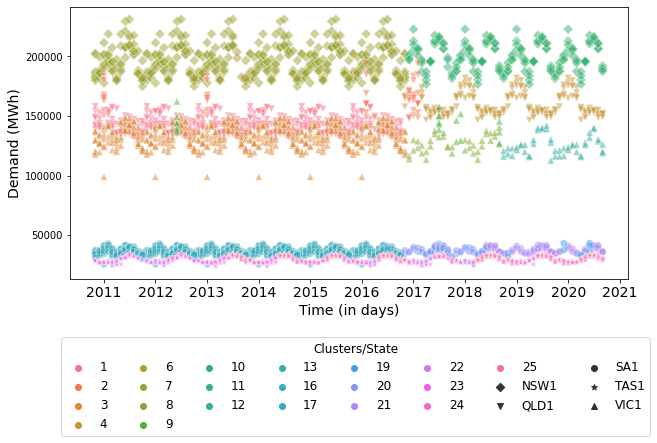

In [218]:
t = helper.get_additional_col_month(df, 'demand')
fig, ax = plt.subplots(figsize=(10, 5))
X = t.copy()
mkr_dict ={'NSW1': 'D', 'QLD1': 'v', 'SA1': 'o', 'VIC1':'^', 'TAS1' :'*'}
g = sns.scatterplot(x = 'datetime', y = 'demand', hue='clust_category', style='state', s = 50,
                    markers = mkr_dict, data = X, alpha = 0.5, legend='brief')

handles, labels = ax.get_legend_handles_labels()
# for idx, txt in enumerate(labels):
#     print('{} - {}'.format(idx, txt))
labels = labels[1:22] + labels[23:]
handles = handles[1:22] + handles[23:]
g.legend(handles=handles, labels=labels, fontsize = 12,
        loc=4, ncol= 8, bbox_to_anchor=(1.05, -0.6), title = 'Clusters/State', title_fontsize = 12)

# Set x-axis label
plt.xlabel('Time (in days)', fontsize = 14)
a = plt.xticks(fontsize= 14)
# Set y-axis label
plt.ylabel('Demand (MWh)', fontsize = 14)
a = plt.xticks(fontsize= 14)

### RRP

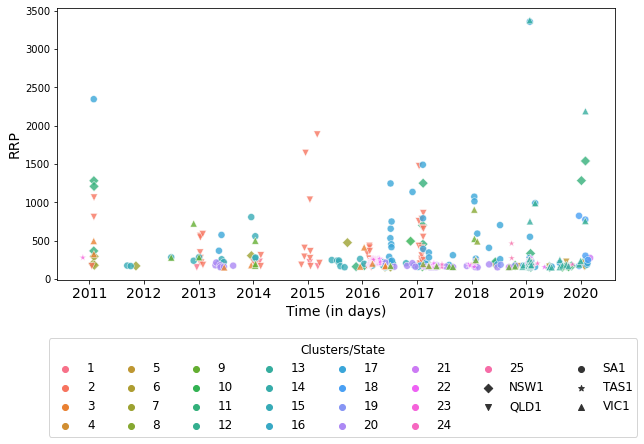

In [181]:
fig, ax = plt.subplots(figsize=(10, 5))
X = df[df.rrp>150]
mkr_dict ={'NSW1': 'D', 'QLD1': 'v', 'SA1': 'o', 'VIC1':'^', 'TAS1' :'*'}
g = sns.scatterplot(x = 'datetime', y = 'rrp', hue='clust_category', style='state', s = 50,
                    markers = mkr_dict, data = X, alpha = 0.8, legend='brief')

handles, labels = ax.get_legend_handles_labels()

labels = labels[1:26] + labels[27:]
handles = handles[1:26] + handles[27:]
g.legend(handles=handles, labels=labels, fontsize = 12,
        loc=4, ncol= 8, bbox_to_anchor=(1.05, -0.6), title = 'Clusters/State',title_fontsize = 12)

# Set x-axis label
plt.xlabel('Time (in days)', fontsize = 14)
a = plt.xticks(fontsize= 14)
# Set y-axis label
plt.ylabel('RRP', fontsize = 14)
a = plt.xticks(fontsize= 14)

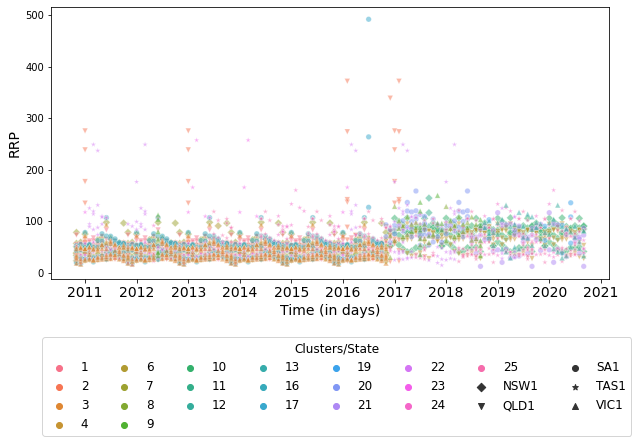

In [186]:
t = helper.get_additional_col_month(df, 'rrp')
fig, ax = plt.subplots(figsize=(10, 5))
X = t.copy()
mkr_dict ={'NSW1': 'D', 'QLD1': 'v', 'SA1': 'o', 'VIC1':'^', 'TAS1' :'*'}
g = sns.scatterplot(x = 'datetime', y = 'rrp', hue='clust_category', style='state', s = 30,
                    markers = mkr_dict, data = X, alpha = 0.5, legend='brief')

handles, labels = ax.get_legend_handles_labels()
# for idx, txt in enumerate(labels):
#     print('{} - {}'.format(idx, txt))
labels = labels[1:22] + labels[23:]
handles = handles[1:22] + handles[23:]
g.legend(handles=handles, labels=labels, fontsize = 12,
        loc=4, ncol= 8, bbox_to_anchor=(1.05, -0.6), title = 'Clusters/State', title_fontsize = 12)

# Set x-axis label
plt.xlabel('Time (in days)', fontsize = 14)
a = plt.xticks(fontsize= 14)
# Set y-axis label
plt.ylabel('RRP', fontsize = 14)
a = plt.xticks(fontsize= 14)

### Export

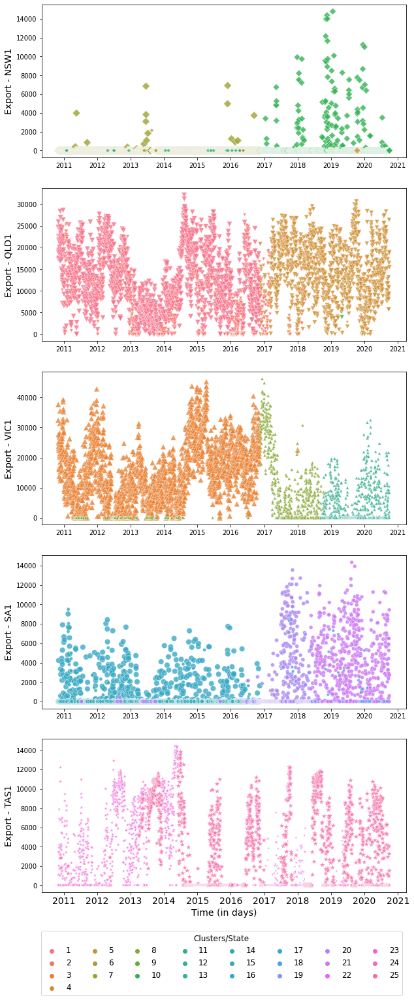

In [216]:
fig, ax = plt.subplots(5, 1, figsize=(10, 25))
X = pd.merge(df, df.groupby(['clust']).size().reset_index(name='count'), on='clust')
mkr_dict ={'NSW1': 'D', 'QLD1': 'v', 'SA1': 'o', 'VIC1':'^', 'TAS1' :'*'}
g = sns.scatterplot(x = 'datetime', y = 'export', hue='clust_category', 
                    style='state', size='count', ax = ax[0], 
                    markers = mkr_dict, data = X[X.state=='NSW1'], alpha = 0.8, legend=False)
ax[0].set_ylabel('Export - NSW1', fontsize = 14)
ax[0].set_xlabel('')


g = sns.scatterplot(x = 'datetime', y = 'export', hue='clust_category', 
                    style='state', size='count', ax = ax[1],
                    markers = mkr_dict, data = X[X.state=='QLD1'], alpha = 0.8, legend=False)
ax[1].set_ylabel('Export - QLD1', fontsize = 14)
ax[1].set_xlabel('')

g = sns.scatterplot(x = 'datetime', y = 'export', hue='clust_category', 
                    style='state', size='count', ax = ax[2],
                    markers = mkr_dict, data = X[X.state=='VIC1'], alpha = 0.8, legend=False)
ax[2].set_ylabel('Export - VIC1', fontsize = 14)
ax[2].set_xlabel('')

g = sns.scatterplot(x = 'datetime', y = 'export', hue='clust_category', 
                    style='state', size='count', ax = ax[3],
                    markers = mkr_dict, data = X[X.state=='SA1'], alpha = 0.8, legend = False)
ax[3].set_ylabel('Export - SA1', fontsize = 14)
ax[3].set_xlabel('')

g = sns.scatterplot(x = 'datetime', y = 'export', hue='clust_category', 
                    style='state', size='count', ax = ax[4],
                    markers = mkr_dict, data = X[X.state=='TAS1'], alpha = 0.8, legend='brief')
ax[4].set_ylabel('Export - TAS1', fontsize = 14)


handles, labels = ax[4].get_legend_handles_labels()

labels = labels[1:26] 
handles = handles[1:26]
g.legend(handles=handles, labels=labels, fontsize = 12,
        loc=4, ncol= 8, bbox_to_anchor=(1.0, -0.7), title = 'Clusters/State',title_fontsize = 12)

# Set x-axis label
plt.xlabel('Time (in days)', fontsize = 14)
a = plt.xticks(fontsize= 14)

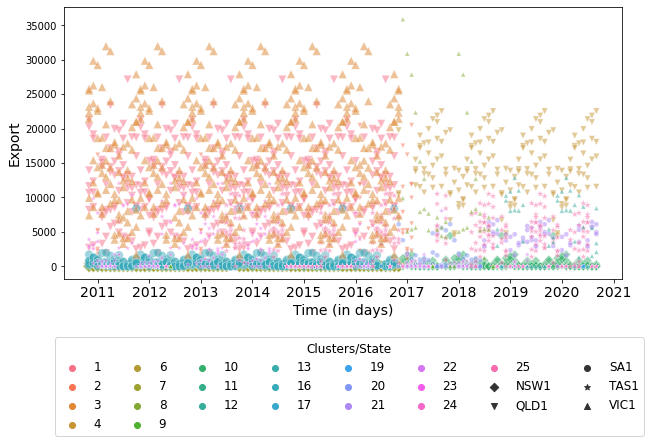

In [197]:
t = helper.get_additional_col_month(df, 'export')
fig, ax = plt.subplots(figsize=(10, 5))
# X = t.copy()
X = pd.merge(t, t.groupby(['clust']).size().reset_index(name='count'), on='clust')
mkr_dict ={'NSW1': 'D', 'QLD1': 'v', 'SA1': 'o', 'VIC1':'^', 'TAS1' :'*'}
g = sns.scatterplot(x = 'datetime', y = 'export', hue='clust_category', style='state', size = 'count',
                    markers = mkr_dict, data = X, alpha = 0.5, legend='brief')

handles, labels = ax.get_legend_handles_labels()
# for idx, txt in enumerate(labels):
#     print('{} - {}'.format(idx, txt))
labels = labels[1:22] + labels[29:]
handles = handles[1:22] + handles[29:]
g.legend(handles=handles, labels=labels, fontsize = 12,
        loc=4, ncol= 8, bbox_to_anchor=(1.05, -0.6), title = 'Clusters/State', title_fontsize = 12)

# Set x-axis label
plt.xlabel('Time (in days)', fontsize = 14)
a = plt.xticks(fontsize= 14)
# Set y-axis label
plt.ylabel('Export', fontsize = 14)
a = plt.xticks(fontsize= 14)

### 2 dimensional view

Text(0, 0.5, 'Dimension 2')

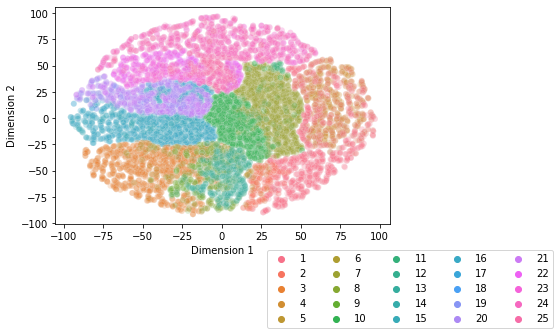

In [29]:
Z = pd.DataFrame(pickle.load(open('models/ftz_daily_5.pkl', 'rb')))
Z = Z.rename(columns={0: "dim1", 1: "dim2"})
Z['state'] = df['state'].astype('str').astype('category')
Z['clust_category'] = df['clust_category']

g = sns.scatterplot(x="dim1", y="dim2", hue="clust_category", data=Z, edgecolors='none', alpha = 0.1)
# sns.despine(bottom=True)
g.legend(loc=4, ncol= 5, bbox_to_anchor=(1.5, -0.5))
# Set x-axis label
plt.xlabel('Dimension 1')
# Set y-axis label
plt.ylabel('Dimension 2')

In [60]:
import random
import warnings
warnings.filterwarnings('ignore')


SMALL_SIZE = 100
MEDIUM_SIZE = 120

energy_cols = ['wind', 'solar', 'solar_rooftop', 'blackcoal', 'browncoal','gas','diesel','kerosene','hydro','bagasse','batterys', 'net_import']
additional_cols = ['export', 'demand']

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=MEDIUM_SIZE, markerscale = 10)    # legend fontsize
# plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

# sample 15K points
Xplot = pd.DataFrame()
for s in df.state.unique():
    X_sub = df[df.state == s]
    max_sample = 5000 if X_sub.shape[0] > 5000 else X_sub.shape[0]
    X_sub = X_sub.iloc[random.sample(range(0, X_sub.shape[0]), max_sample),:]
    Xplot = pd.concat([Xplot, X_sub])
    
pp = sns.pairplot(Xplot[energy_cols + additional_cols + ['clust_category']], hue = 'clust_category', diag_kind = 'kde',
             plot_kws = {'alpha': 0.5, 'edgecolor': 'k'}, height = 10)
plt.show()